# HW1 - Sasha (Alexander) & Shaul

## Section A

1. Read 4 columns, i.e. 'from_x', 'from_y', 'to_x', 'to_y' from the data into Python using Pandas.

In [1]:
import geopandas as gpd
import pandas as pd

file_path = 'data/travelTimes_2015_Helsinki.csv'
data = pd.read_csv(file_path, usecols = ['from_x', 'from_y', 'to_x', 'to_y'])
data = gpd.GeoDataFrame(data)
pd.DataFrame(data.columns.to_list(),columns=['Column Name'])

,Column Name
0,from_x
1,from_y
2,to_x
3,to_y


2.Create two lists called orig_points and dest_points

In [2]:
orig_points = []
dest_points = []

3. Iterate over the rows of your DataFrame and add Shapely Point -objects into the orig_points -list and dest_point -list representing the origin locations and destination locations accordingly.

In [3]:
from shapely.geometry import Point
import numpy as np
orig_points = list(map(lambda x:Point(x[1]['from_x'],x[1]['from_y']),data.iterrows()))
dest_points = list(map(lambda x:Point(x[1]['to_x'],x[1]['to_y']),data.iterrows()))

print('Type of "orig_points" is: {}'.format(type(orig_points)))
print('Type of elements in "orig_points" is: {}'.format(type(orig_points[0])))
print('Exemple of element is: {}'.format(orig_points[0]))

Type of "orig_points" is: <class 'list'>
Type of elements in "orig_points" is: <class 'shapely.geometry.point.Point'>
Exemple of element is: POINT (24.9704379 60.3119173)


4. Compute Movements

4.1 Create a list called lines

In [4]:
lines = []

4.2 Iterate over the origin and destination lists and create a Shapely 
LineString -object between the origin and destination point. 

| Column | Description              |
|--------|--------------------------|
| Lat    | y-coordinate of the post |
| Lon    | x-coordinate of the post |


In [5]:
from shapely.geometry import LineString
lines = list(map(lambda pair: LineString(pair),zip(orig_points,dest_points)))
print('Exemple of element cords is: {}'.format(list(lines[0].coords)))


Exemple of element cords is: [(24.9704379, 60.3119173), (24.8560344, 60.399940599999994)]


4.3 Add that line into the lines -list.Find out what is the average distance of all the origin-destination LineStrings that we just created andprint it out.

In [6]:
average_dist = np.average(list(map(lambda x: x.length,lines)))
print('Average disntance in list "{0}" is: {1}'.format('lines',average_dist))

Average disntance in list "lines" is: 0.21502224823227248


## Section B

### Part 1

1. Read the data into memory using Pandas

In [7]:
data2 = pd.read_csv('data/some_posts.csv')
print(data2)

             lat        lon         timestamp    userid
0     -24.980792  31.484633  2015-07-07 03:02  66487960
1     -25.499225  31.508906  2015-07-07 03:18  65281761
2     -24.342578  30.930866  2015-03-07 03:38  90916112
3     -24.854614  31.519718  2015-10-07 05:04  37959089
4     -24.921069  31.520836  2015-10-07 05:19  27793716
...          ...        ...               ...       ...
81374 -24.799541  31.354469  2015-09-05 02:23  90744213
81375 -25.467992  30.956033  2015-02-05 02:40  71109799
81376 -25.332223  30.997409  2015-08-05 02:40  54796261
81377 -25.508851  31.005536  2015-08-05 02:43  78762204
81378 -25.498840  31.007430  2015-04-05 02:44  32190273

[81379 rows x 4 columns]


2. Create an empty column called geometry where you will store shapely Point objects

In [34]:
data2['geometry'] = ""
print(data2)

             lat        lon         timestamp    userid geometry
0     -24.980792  31.484633  2015-07-07 03:02  66487960         
1     -25.499225  31.508906  2015-07-07 03:18  65281761         
2     -24.342578  30.930866  2015-03-07 03:38  90916112         
3     -24.854614  31.519718  2015-10-07 05:04  37959089         
4     -24.921069  31.520836  2015-10-07 05:19  27793716         
...          ...        ...               ...       ...      ...
81374 -24.799541  31.354469  2015-09-05 02:23  90744213         
81375 -25.467992  30.956033  2015-02-05 02:40  71109799         
81376 -25.332223  30.997409  2015-08-05 02:40  54796261         
81377 -25.508851  31.005536  2015-08-05 02:43  78762204         
81378 -25.498840  31.007430  2015-04-05 02:44  32190273         

[81379 rows x 5 columns]


3. Iterate over the rows of the DataFrame and insert Point objects into column geometry (you mightuse .loc indexer to update the row

In [35]:
list_of_points = list(map(lambda row: Point(row[1][1],row[1][0]),data2.iterrows()))
data2['geometry'] = list_of_points
print(data2)

             lat        lon         timestamp    userid  \
0     -24.980792  31.484633  2015-07-07 03:02  66487960   
1     -25.499225  31.508906  2015-07-07 03:18  65281761   
2     -24.342578  30.930866  2015-03-07 03:38  90916112   
3     -24.854614  31.519718  2015-10-07 05:04  37959089   
4     -24.921069  31.520836  2015-10-07 05:19  27793716   
...          ...        ...               ...       ...   
81374 -24.799541  31.354469  2015-09-05 02:23  90744213   
81375 -25.467992  30.956033  2015-02-05 02:40  71109799   
81376 -25.332223  30.997409  2015-08-05 02:40  54796261   
81377 -25.508851  31.005536  2015-08-05 02:43  78762204   
81378 -25.498840  31.007430  2015-04-05 02:44  32190273   

                                 geometry  
0      POINT (31.484633302 -24.980792492)  
1      POINT (31.508905612 -25.499224667)  
2      POINT (30.930866066 -24.342578456)  
3       POINT (31.519718439 -24.85461393)  
4      POINT (31.520835558 -24.921068894)  
...                        

4. Convert that DataFrame into a GeoDataFrame 

In [36]:
data2_geo = gpd.GeoDataFrame(data2, geometry='geometry')
print('The type of new dataset is: {}'.format(type(data2_geo)))

The type of new dataset is: <class 'geopandas.geodataframe.GeoDataFrame'>


5. Update the CRS for coordinate system as WGS84

In [37]:
data2_geo.set_crs(epsg=4326, inplace=True)
print("The CRS of the GeoPandas Frame is: ",data2_geo.crs)

The CRS of the GeoPandas Frame is:  epsg:4326


6. Output: Save the data into a Shapefile called Kruger_posts.shp

In [22]:

data2_geo.to_file("output_shp/Kruger_posts.shp")


7. Create a simple map of those points using a GIS software anduse.plot()-function in Python.

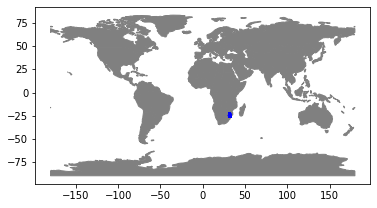

In [25]:
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres')) #Requests 'descartes' module
base = world.plot(color='gray', edgecolor='gray')
data2_geo.plot(ax=base, marker='o', color='blue', markersize=1);

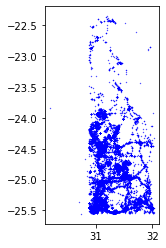

In [29]:
data2_geo.plot(marker='o', color='blue', markersize=0.1);

### Part 2

1. Reproject the data from WGS84 projection into EPSG:32735 -projection 

In [40]:
data3 = data2_geo.copy()
data3.to_crs(epsg=32735, inplace=True)
print(data3)

             lat        lon         timestamp    userid  \
0     -24.980792  31.484633  2015-07-07 03:02  66487960   
1     -25.499225  31.508906  2015-07-07 03:18  65281761   
2     -24.342578  30.930866  2015-03-07 03:38  90916112   
3     -24.854614  31.519718  2015-10-07 05:04  37959089   
4     -24.921069  31.520836  2015-10-07 05:19  27793716   
...          ...        ...               ...       ...   
81374 -24.799541  31.354469  2015-09-05 02:23  90744213   
81375 -25.467992  30.956033  2015-02-05 02:40  71109799   
81376 -25.332223  30.997409  2015-08-05 02:40  54796261   
81377 -25.508851  31.005536  2015-08-05 02:43  78762204   
81378 -25.498840  31.007430  2015-04-05 02:44  32190273   

                             geometry  
0      POINT (952912.890 7229683.258)  
1      POINT (953433.223 7172080.632)  
2      POINT (898955.144 7302197.408)  
3      POINT (956927.218 7243564.942)  
4      POINT (956794.955 7236187.926)  
...                               ...  
81374  POIN

2. Group the data by userid

In [46]:
data3_grouped = data3.groupby('userid')
print(data3_grouped.get_group(66487960))

         lat        lon         timestamp    userid  \
0 -24.980792  31.484633  2015-07-07 03:02  66487960   

                         geometry  
0  POINT (952912.890 7229683.258)  


3. Create an empty GeoDataFrame called movements

In [106]:
movements = gpd.GeoDataFrame(columns=['userid','geometry'],geometry='geometry')
print(movements)

Empty GeoDataFrame
Columns: [userid, geometry]
Index: []


4. Sort for each user

In [107]:

for name, group in data3_grouped:
    group = group.sort_values(by='timestamp',ascending=True)
    if group.shape[0] == 1:
        continue # Skipingon users that havent moved (only one point)
    polyline = LineString(group.geometry.to_list())
    temp_df = pd.DataFrame([[name,polyline]],columns=['userid','geometry'])
    temp_df = gpd.GeoDataFrame(temp_df,geometry='geometry')
    movements = gpd.GeoDataFrame( pd.concat( [movements,temp_df], ignore_index=True))
print(movements)

        userid                                           geometry
0        16301  LINESTRING (942231.630 7254606.868, 938934.725...
1        45136  LINESTRING (905394.500 7193375.148, 905394.500...
2        50136  LINESTRING (944551.607 7253384.183, 963788.403...
3        88775  LINESTRING (902800.817 7192546.975, 902800.839...
4        88918  LINESTRING (959332.961 7219877.715, 963788.403...
...        ...                                                ...
9021  99921781  LINESTRING (902885.190 7196931.096, 904027.710...
9022  99936874  LINESTRING (963782.211 7228000.079, 963754.402...
9023  99964140  LINESTRING (938876.653 7305143.369, 938876.943...
9024  99986933  LINESTRING (935937.029 7305973.536, 936598.681...
9025  99990870  LINESTRING (899089.377 7180296.561, 899089.377...

[9026 rows x 2 columns]


5. Determine the CRS of the movements GeoDataFrame to EPSG:32735

In [108]:
movements.set_crs(epsg=32735, inplace=True)

,userid,geometry
0,16301,"LINESTRING (942231.630 7254606.868, 938934.725..."
1,45136,"LINESTRING (905394.500 7193375.148, 905394.500..."
2,50136,"LINESTRING (944551.607 7253384.183, 963788.403..."
3,88775,"LINESTRING (902800.817 7192546.975, 902800.839..."
4,88918,"LINESTRING (959332.961 7219877.715, 963788.403..."
...,...,...
9021,99921781,"LINESTRING (902885.190 7196931.096, 904027.710..."
9022,99936874,"LINESTRING (963782.211 7228000.079, 963754.402..."
9023,99964140,"LINESTRING (938876.653 7305143.369, 938876.943..."
9024,99986933,"LINESTRING (935937.029 7305973.536, 936598.681..."


6. Calculate the lengths of the lines into a new column called distance in movements GeoDataFrame

In [122]:
movements['distance'] = ''
distance = list(map(lambda x:x[1][1].length,movements.iterrows()))
movements['distance'] = distance
print(movements)



        userid                                           geometry  \
0        16301  LINESTRING (942231.630 7254606.868, 938934.725...   
1        45136  LINESTRING (905394.500 7193375.148, 905394.500...   
2        50136  LINESTRING (944551.607 7253384.183, 963788.403...   
3        88775  LINESTRING (902800.817 7192546.975, 902800.839...   
4        88918  LINESTRING (959332.961 7219877.715, 963788.403...   
...        ...                                                ...   
9021  99921781  LINESTRING (902885.190 7196931.096, 904027.710...   
9022  99936874  LINESTRING (963782.211 7228000.079, 963754.402...   
9023  99964140  LINESTRING (938876.653 7305143.369, 938876.943...   
9024  99986933  LINESTRING (935937.029 7305973.536, 936598.681...   
9025  99990870  LINESTRING (899089.377 7180296.561, 899089.377...   

           distance  
0     328455.115430  
1          0.000000  
2     159189.081019  
3          0.080245  
4       9277.252211  
...             ...  
9021  211162.6959

7. Save the movements of into a Shapefile called Some_movements.shp

In [125]:
movements.to_file("output_shp/Some_movements.shp")

8. Create a simple map of those points using a GIS software and use.plot() -function in Python

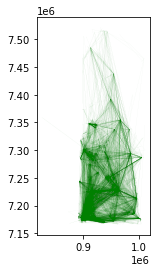

In [130]:
movements.plot(color='green', linewidth=0.01);

### Questions

In [165]:
gpd_no_zero = movements[movements['distance'] > 0.0]
print("Static userids weren't included!\n")

print('What was the shortest distance travelled in meters?')
min_dist = gpd_no_zero['distance'].min()
print('The shortest distance travelled in meters is: ',min_dist)

mean_dist = gpd_no_zero['distance'].mean()
print('\nWhat was the average distance travelled in meters?')
print('The average distance travelled in meters is: ',mean_dist)

max_dist = gpd_no_zero['distance'].max()
print('\nWhat was the maximum distance travelled in meters?')
print('The maximum distance travelled in meters is: ',max_dist)


Static userids weren't included!

What was the shortest distance travelled in meters?
The shortest distance travelled in meters is:  0.00010161849156075795

What was the average distance travelled in meters?
The average distance travelled in meters is:  117438.31425525388

What was the maximum distance travelled in meters?
The maximum distance travelled in meters is:  6970668.816343958


## Section C